In [23]:
# some builtin imports
import re
import warnings
from collections import Counter
import time
from datetime import datetime
warnings.filterwarnings('ignore')

# Some usual imports here
import csv 
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
from mpl_toolkits.axes_grid1 import make_axes_locatable
from pandas.plotting import table

# import stats modules
import scipy.stats as stats
import statsmodels.api as sm
import statsmodels.stats.api as sms

# sklearn models
from sklearn.preprocessing import StandardScaler

# import geo libs
import geopandas as gpd
import folium as fm
from folium.plugins import HeatMap, MarkerCluster
from shapely.geometry import Point, Polygon
import contextily as ctx
from geopy.distance import great_circle
import geoplot as gplt
import geoplot.crs as gcrs

# nlp
import nltk
from textblob import TextBlob
from nltk.corpus import stopwords
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

## Customize Matplotlib Parameters
%matplotlib inline
mpl.rcParams['figure.dpi']= 300
mpl.rcParams['figure.edgecolor']= 'black'
mpl.rcParams['axes.linewidth']= .5
# Customize Seaborn Parameters
sns.set()
rc = {
      'font.family': ['serif'], 
      'font.serif':'Times New Roman',
      'grid.color': 'gainsboro',
      'grid.linestyle': '-', 
}
sns.set_style(rc=rc)
sns.set_context("notebook", font_scale=0.8)

# define constant variables
LONDON_CENTROID = (51.510444, -0.115639)

In [24]:
#nltk.download('stopwords')
# nltk.download('punkt')
STOP_WORDS = set(stopwords.words('english'))

# load data

In [25]:
df = pd.read_csv("data/airbnb_listings_london_full.csv")

In [26]:
df.head()

,id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,...,instant_bookable,is_business_travel_ready,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,11551,https://www.airbnb.com/rooms/11551,20190914144451,2019-09-15,Arty and Bright London Apartment in Zone 2,Unlike most rental apartments out there my fla...,"Amenities Bedding: 1 Double bed, 1 living room...",Unlike most rental apartments out there my fla...,family,Not even 10 minutes by metro from Victoria Sta...,...,t,f,strict_14_with_grace_period,f,t,2,2,0,0,1.59
1,13913,https://www.airbnb.com/rooms/13913,20190914144451,2019-09-15,Holiday London DB Room Let-on going,My bright double bedroom with a large window h...,"Hello Everyone, I'm offering my lovely double ...",My bright double bedroom with a large window h...,business,Finsbury Park is a friendly melting pot commun...,...,f,f,moderate,f,f,3,1,2,0,0.14
2,15400,https://www.airbnb.com/rooms/15400,20190914144451,2019-09-15,Bright Chelsea Apartment. Chelsea!,Lots of windows and light. St Luke's Gardens ...,Bright Chelsea Apartment This is a bright one...,Lots of windows and light. St Luke's Gardens ...,romantic,It is Chelsea.,...,t,f,strict_14_with_grace_period,t,t,1,1,0,0,0.73
3,17402,https://www.airbnb.com/rooms/17402,20190914144451,2019-09-15,Superb 3-Bed/2 Bath & Wifi: Trendy W1,You'll have a wonderful stay in this superb mo...,"This is a wonderful very popular beautiful, sp...",You'll have a wonderful stay in this superb mo...,none,"Location, location, location! You won't find b...",...,t,f,strict_14_with_grace_period,f,f,15,15,0,0,0.40
4,24328,https://www.airbnb.com/rooms/24328,20190914144451,2019-09-15,Battersea bedroom & office w parking shared ga...,"Artist house, bright high ceiling rooms, priva...",- End of terrace two bedroom house close to So...,"Artist house, bright high ceiling rooms, priva...",family,"- Battersea is a quiet family area, easy acces...",...,f,f,moderate,t,t,1,1,0,0,0.86


In [27]:
# load london bounday shapefile into geodataframe
geo_df = gpd.read_file("assets/statistical-gis-boundaries-london/ESRI/London_Borough_Excluding_MHW.shp")
geo_df.head()

,NAME,GSS_CODE,HECTARES,NONLD_AREA,ONS_INNER,SUB_2009,SUB_2006,geometry
0,Kingston upon Thames,E09000021,3726.117,0.000,F,None,None,"POLYGON ((516401.600 160201.800, 516407.300 16..."
1,Croydon,E09000008,8649.441,0.000,F,None,None,"POLYGON ((535009.200 159504.700, 535005.500 15..."
2,Bromley,E09000006,15013.487,0.000,F,None,None,"POLYGON ((540373.600 157530.400, 540361.200 15..."
3,Hounslow,E09000018,5658.541,60.755,F,None,None,"POLYGON ((521975.800 178100.000, 521967.700 17..."
4,Ealing,E09000009,5554.428,0.000,F,None,None,"POLYGON ((510253.500 182881.600, 510249.900 18..."


# Clean data

In [28]:
# and some others we will not use such as id
# columns for airbnb listings
selected_columns = [
    'name', 'beds', 'bathrooms', 'bedrooms', 'amenities', 'summary', 'availability_365',
    'cancellation_policy', 'experiences_offered', 'host_is_superhost', 'beds', 'bed_type',
    'latitude', 'longitude', 'number_of_reviews', 'reviews_per_month', 'instant_bookable', 'room_type',
    'description', 'accommodates', 'neighbourhood_cleansed', 'price',
    'review_scores_accuracy', 'review_scores_cleanliness', 'cleaning_fee',
    'review_scores_checkin', 'review_scores_communication', 'review_scores_location',
]
df.drop(columns=[c for c in df.columns if c not in selected_columns], inplace=True)
# Using cancellation policy from airbnb website to group policies into Flexible, Moderate, and Strict
# https://www.airbnb.co.uk/home/cancellation_policies
df.replace({
    'cancellation_policy': {
        'strict_14_with_grace_period': 'strict',
        'super_strict_30': 'strict',
        'super_strict_60': 'strict',
        'luxury_super_strict_95': 'strict',
        'luxury_moderate': 'moderate'
    }
}, inplace=True)

# drop unused columns in bounday shapefile
geo_df.drop(columns=['GSS_CODE', 'HECTARES', 'NONLD_AREA', 'ONS_INNER', 'SUB_2009', 'SUB_2006'], inplace=True)

In [29]:
df.head()

,name,summary,description,experiences_offered,host_is_superhost,neighbourhood_cleansed,latitude,longitude,room_type,accommodates,...,availability_365,number_of_reviews,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,instant_bookable,cancellation_policy,reviews_per_month
0,Arty and Bright London Apartment in Zone 2,Unlike most rental apartments out there my fla...,Unlike most rental apartments out there my fla...,family,t,Lambeth,51.46225,-0.11732,Entire home/apt,4,...,344,184,9.0,9.0,10.0,10.0,9.0,t,strict,1.59
1,Holiday London DB Room Let-on going,My bright double bedroom with a large window h...,My bright double bedroom with a large window h...,business,f,Islington,51.56802,-0.11121,Private room,2,...,353,16,9.0,10.0,9.0,10.0,9.0,f,moderate,0.14
2,Bright Chelsea Apartment. Chelsea!,Lots of windows and light. St Luke's Gardens ...,Lots of windows and light. St Luke's Gardens ...,romantic,t,Kensington and Chelsea,51.48796,-0.16898,Entire home/apt,2,...,114,87,10.0,10.0,10.0,10.0,10.0,t,strict,0.73
3,Superb 3-Bed/2 Bath & Wifi: Trendy W1,You'll have a wonderful stay in this superb mo...,You'll have a wonderful stay in this superb mo...,none,t,Westminster,51.52098,-0.14002,Entire home/apt,6,...,265,41,10.0,9.0,9.0,9.0,10.0,t,strict,0.40
4,Battersea bedroom & office w parking shared ga...,"Artist house, bright high ceiling rooms, priva...","Artist house, bright high ceiling rooms, priva...",family,f,Wandsworth,51.47298,-0.16376,Entire home/apt,2,...,346,93,10.0,10.0,10.0,10.0,9.0,f,moderate,0.86


In [30]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 85273 entries, 0 to 85272
Data columns (total 27 columns):
name                           85248 non-null object
summary                        81043 non-null object
description                    83021 non-null object
experiences_offered            85273 non-null object
host_is_superhost              85257 non-null object
neighbourhood_cleansed         85273 non-null object
latitude                       85273 non-null float64
longitude                      85273 non-null float64
room_type                      85273 non-null object
accommodates                   85273 non-null int64
bathrooms                      85146 non-null float64
bedrooms                       85231 non-null float64
beds                           85120 non-null float64
bed_type                       85273 non-null object
amenities                      85273 non-null object
price                          85273 non-null object
cleaning_fee                   63744 no

# Missing values

In [31]:
# first we check for missing values in the dataset by defining a function to compute missing data.
def compute_missing_data(df):
    """Function to compute missing data count and percentage and output a table"""
    mising_sum = df.isnull().sum()
    total = mising_sum.sort_values(ascending=False)

    percent = (mising_sum*100)/df.isnull().count().sort_values(ascending=False)
    missing_data = pd.concat([total, percent], axis=1, keys=['Total','Percent'], 
                             sort=False).sort_values('Total', ascending=False)
    return missing_data

# define a function to cleanup price column
def clean_price(val):
    """A function to remove dollar sign in prices, convert it to float type and 
    finally convert it to pounds"""
    if not isinstance(val, (float, int)):
        val = float(val.replace('$', '').replace(',', ''))
    pound_to_dollar_rate = 0.76
    return val*pound_to_dollar_rate

# print table containing missing data
compute_missing_data(df)

,Total,Percent
review_scores_checkin,22781,26.715373
review_scores_location,22780,26.714200
review_scores_accuracy,22733,26.659083
review_scores_communication,22726,26.650874
review_scores_cleanliness,22720,26.643838
cleaning_fee,21529,25.247147
reviews_per_month,21003,24.630305
summary,4230,4.960539
description,2252,2.640930
beds,153,0.179424


In [32]:
# first convert columns to appropriate types
# convert price and cleaning_fee to numeric
df.loc[:, 'price'] = df.loc[:, 'price'].apply(clean_price)
df.loc[:, 'cleaning_fee'] = df.loc[:, 'cleaning_fee'].apply(clean_price)
# rename neighbourhood_cleansed column
df.rename(columns={'neighbourhood_cleansed': 'borough'}, inplace=True)
## Transform Categorical Columns into pandas.category type
cat_cols = ['experiences_offered', 'host_is_superhost', 'room_type', 'cancellation_policy', 'instant_bookable', 'borough', 'bed_type']
df[cat_cols] = df[cat_cols].apply(lambda x: x.astype('category'))

# filling missing values
# Textual attributes such as description, summary and space are going to be imputed by an empty string. 
# The reviews_per_month refers to number of reviews per month, it was probably not scraped properly or that listings have no reviews at all; hence it'll be replaced with 0
# bathrooms and bedrooms being a fixed numeric, will be replaced using the mean, and cleaning_fee being numeric, 
# the median applies as a central tendency measure since the distribution is skewed.
# host_is_superhost being a categorical indicating super host or not will be replaced by 'f'
df = df.fillna(value={
    'reviews_per_month':0,
    'review_scores_checkin': 0,
    'review_scores_location': 0,
    'review_scores_accuracy': 0,
    'review_scores_communication': 0,
    'review_scores_cleanliness': 0,
    'beds': np.floor(df.beds.mean()),
    'bathrooms': np.floor(df.bathrooms.mean()),
    'bedrooms': np.floor(df.bedrooms.mean()),
    'summary': '',
    'space': '',
    'description': '',
    'name': '',
    'host_is_superhost': 'f',
    'cleaning_fee': df.cleaning_fee.median(),
})

In [33]:
# print table containing missing data
compute_missing_data(df)

,Total,Percent
reviews_per_month,0,0.0
cancellation_policy,0,0.0
instant_bookable,0,0.0
review_scores_location,0,0.0
review_scores_communication,0,0.0
review_scores_checkin,0,0.0
review_scores_cleanliness,0,0.0
review_scores_accuracy,0,0.0
number_of_reviews,0,0.0
availability_365,0,0.0


# Feature Engineering

In [34]:
def clean_amenities(value):
    """A function to remove unwanted characters and convert it to list of words"""
    return value.strip('{}')\
             .replace('"', '')\
             .lstrip('\"')\
             .rstrip('\"')\
             .split(',')

def calculate_occupancy_rate(row, review_rate):
    """Calculate occupancy rate of a listing
    Occupancy Rate = Booked Nights * average length of stay in London
    """
    # Here we assume a guest may leave a review after their stay, so we'll use number_of_reviews and 
    # estimated number of average length of stay in London (4.6 night per stay).
    lenth_of_stay = 4.6
    booked_nights = row['reviews_per_month'] / review_rate
    return round(booked_nights * lenth_of_stay, 2)


def get_sentiment(avg):
    if avg > 0:
        return 'positive'
    elif avg < 0:
        return 'negative'
    return 'neutral'


# create a column amenities_count by spliting amenities text by comma and count the total words present in each row
df['amenities'] = df['amenities'].apply(clean_amenities)
df['amenities_count'] = df['amenities'].apply(np.count_nonzero)


# I used regular expressions to find all strings in case of punctuation marks or special characters in the string
# Finally count the number of words
description_cols = ['summary', 'description']
for col in description_cols:
    df[f'{col}_count'] = df[col].apply(lambda x: len(re.findall(r'\w+', x)))
    df[f'{col}_sentiment_score'] = df[col].apply(lambda x: TextBlob(x).sentiment.polarity)

# drop description columns since we only need the count for the scope of the analysis
df.drop(columns=description_cols, inplace=True)
df['average_sentiment'] = df.apply(lambda x: round(np.mean([x.summary_sentiment_score, x.description_sentiment_score]), 2), axis=1)

df['sentiment'] = df.average_sentiment.apply(lambda x: get_sentiment(x))
df.sentiment = df.sentiment.astype('category')

# tokenize name
df['name'] = df.name.apply(lambda x: [w for w in TextBlob(x).words if w not in STOP_WORDS])

# Now let's try for a more optimistic estimate of occupancy using a review rate of 0.3, which assumes that only 30% of all guests left a review.
# using average 30% as optimistic review rate
modest_review_rate = 0.5
df['modest_occupancy'] = df.apply(lambda x: calculate_occupancy_rate(x, modest_review_rate), axis=1)
# occupancy cannot be greater than 100% - probably mistakes during scrapping of the data?
print('Number of occupancy greater than 100%:', len(df[df['modest_occupancy'] > 100]))
# let's drop optimistic_occupancy rates > 100
df.drop(df[(df['modest_occupancy'] > 100)].index, axis=0, inplace=True)

optimistic_review_rate = 0.3
df['optimistic_occupancy'] = df.apply(lambda x: calculate_occupancy_rate(x, optimistic_review_rate), axis=1)

# occupancy cannot be greater than 100% - probably mistakes during scrapping of the data?
print('Number of occupancy greater than 100%:', len(df[df['optimistic_occupancy'] > 100]))
# let's drop optimistic_occupancy rates > 100
df.drop(df[(df['optimistic_occupancy'] > 100)].index, axis=0, inplace=True)
# income = price * occupancy rate * months in year
df['modest_income'] = df.price * df.modest_occupancy * 12
df['optimistic_income'] = df.price * df.optimistic_occupancy * 12

# Popularity index shows listings popularity based on the number of reviews per 
# listings divided by the total number of reviews in all listings
# calculate total total_reviews
total_reviews = float(df.number_of_reviews.sum())
# calculate popularity index
df['popularity_index'] = (df['number_of_reviews'] / total_reviews) * 100
# drop number_of_reviews columns since it's been transformed
df.drop(columns=['number_of_reviews'], inplace=True)

Number of occupancy greater than 100%: 28
Number of occupancy greater than 100%: 590


In [35]:
geo_df.rename(columns={'NAME': 'borough'}, inplace=True)
geo_df.head()

,borough,geometry
0,Kingston upon Thames,"POLYGON ((516401.600 160201.800, 516407.300 16..."
1,Croydon,"POLYGON ((535009.200 159504.700, 535005.500 15..."
2,Bromley,"POLYGON ((540373.600 157530.400, 540361.200 15..."
3,Hounslow,"POLYGON ((521975.800 178100.000, 521967.700 17..."
4,Ealing,"POLYGON ((510253.500 182881.600, 510249.900 18..."


In [36]:
df.head()

,name,experiences_offered,host_is_superhost,borough,latitude,longitude,room_type,accommodates,bathrooms,bedrooms,...,summary_sentiment_score,description_count,description_sentiment_score,average_sentiment,sentiment,modest_occupancy,optimistic_occupancy,modest_income,optimistic_income,popularity_index
0,"[Arty, Bright, London, Apartment, Zone, 2]",family,t,Lambeth,51.46225,-0.11732,Entire home/apt,4,1.0,1.0,...,0.234377,172,0.198060,0.22,positive,14.63,24.38,11741.4528,19566.4128,0.013617
1,"[Holiday, London, DB, Room, Let-on, going]",business,f,Islington,51.56802,-0.11121,Private room,2,1.0,1.0,...,0.423452,185,0.346639,0.39,positive,1.29,2.15,764.7120,1274.5200,0.001184
2,"[Bright, Chelsea, Apartment, Chelsea]",romantic,t,Kensington and Chelsea,51.48796,-0.16898,Entire home/apt,2,1.0,1.0,...,-0.020833,177,0.158571,0.07,positive,6.72,11.19,6128.6400,10205.2800,0.006439
3,"[Superb, 3-Bed/2, Bath, Wifi, Trendy, W1]",none,t,Westminster,51.52098,-0.14002,Entire home/apt,6,2.0,3.0,...,0.500000,161,0.343737,0.42,positive,3.68,6.13,10068.4800,16771.6800,0.003034
4,"[Battersea, bedroom, office, w, parking, share...",family,f,Wandsworth,51.47298,-0.16376,Entire home/apt,2,1.5,1.0,...,0.084560,170,0.028192,0.06,positive,7.91,13.19,12624.3600,21051.2400,0.006883


In [40]:
df.describe().T



,count,mean,std,min,25%,50%,75%,max
latitude,84655.0,51.509729,0.046354,51.29479,51.485460,51.514060,51.537570,5.168169e+01
longitude,84655.0,-0.127810,0.092287,-0.50916,-0.187980,-0.125920,-0.069870,2.877400e-01
accommodates,84655.0,3.208552,2.026996,1.00000,2.000000,2.000000,4.000000,3.000000e+01
bathrooms,84655.0,1.306296,0.615819,0.00000,1.000000,1.000000,1.500000,1.700000e+01
bedrooms,84655.0,1.420200,0.923930,0.00000,1.000000,1.000000,2.000000,2.200000e+01
beds,84655.0,1.757002,1.278805,0.00000,1.000000,1.000000,2.000000,2.800000e+01
price,84655.0,98.943669,338.843138,0.00000,34.960000,63.840000,106.400000,1.520000e+04
cleaning_fee,84655.0,30.468248,31.411796,0.00000,15.200000,22.800000,38.000000,1.586120e+03
availability_365,84655.0,118.537476,134.800029,0.00000,0.000000,60.000000,252.000000,3.650000e+02
review_scores_accuracy,84655.0,6.947977,4.296343,0.00000,0.000000,9.000000,10.000000,1.000000e+01


In [37]:
df.to_csv("data/processed_airbnb.csv", index=False)

# Exploratory data analysis

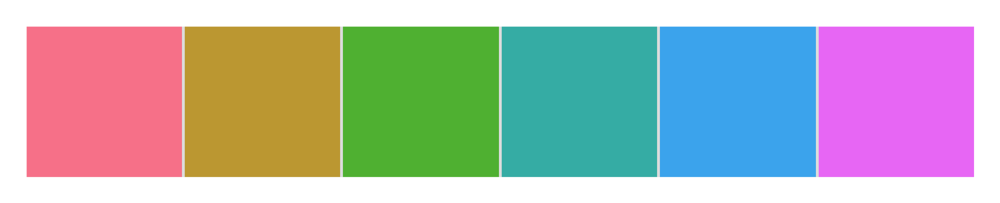

In [56]:
### choose set2 as the default color
color_set = sns.color_palette("husl")

## Set Seaborn Color Palette
sns.set_palette(color_set)

## Visualize Color Palette
sns.palplot(color_set)

In [57]:
# define a reusable function to plot heatmap and choropleth maps
def plot_choropleth_map(df, variable, title=None, cmap='YlOrRd', basemap=True, 
                        map_bg=ctx.providers.Stamen.TonerLite, ax=None, legend_label=None, plot_kwds={}):
    """
    Function to plot choropleth map given a geodataframe and column name
    """
    df = df.to_crs(epsg=3857)
    # create figure and axes for Matplotlib
    if not ax:
        fig, ax = plt.subplots(figsize=(10, 10))
    # create divider
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("bottom", size="5%", pad=0.1)
    legend_kwds = {'orientation': 'horizontal', 'label': legend_label}
    # create map
    df.plot(
        column=variable, cmap=cmap, linewidth=0.5, 
        edgecolor='0.5', ax=ax, alpha=0.6, cax=cax,
        legend=True, legend_kwds=legend_kwds, **plot_kwds
    )
    
    # remove the axis
    _ = ax.set_axis_off()
    
    if title: # add a title
        _ = ax.set_title(title)
    
    if basemap:
        # add base map
        ctx.add_basemap(ax, url=map_bg)
    
    return ax

def plot_folium_heatmap(lat, lon, weights=[]):
    # Visualize the listings using longitude and latitude columns
    xmm=(lat.min()+lat.max())/2
    ymm=(lon.min()+lon.max())/2
    
    if len(weights) <= 0:
        data = [[lt, ln] for lt, ln in zip(lat, lon)]
    else:
        data = [[lt, ln, wt] for lt, ln, wt in zip(lat, lon, weights)]

    hmap = fm.Map(location=[xmm, ymm], zoom_start = 11, control_scale=False)
    # create heat a map using latitude and longitude
    HeatMap(data, radius=7, blur=6, min_opacity=0.2,
            gradient={0.2:'blue',0.4:'purple',0.6:'orange',1.0:'red'}
           ).add_to(hmap)
    # display heatmap
    return hmap

# lollipop chart is really useful if you have 2 observations for each groups.
# Instead of displaying the values of both groups one beside each other, show them on the same line and represent only their difference!
def plot_lollipop(x1_col, x2_col, y_col, about, df, ax=None, show=False):
    """
    Function that creates a lollipop chart with 
    two observations (x-values) per group (y-value).
    https://python-graph-gallery.com/184-lollipop-plot-with-2-groups/
    """
    
    # prepare data
    df_plot = df[[y_col, x1_col, x2_col]].groupby(y_col).apply(lambda x: x.mean()).sort_values(x1_col).reset_index()
        
    # draw plot
    y_range = range(1, len(df_plot.index)+1)
    if not ax:
        fig, ax = plt.subplots(figsize=(12,8))
        
    ax.hlines (y=y_range, xmin=df_plot[x1_col], xmax=df_plot[x2_col], color='grey', alpha=0.4)
    ax.scatter(y=y_range, x=df_plot[x1_col], s=75, color='skyblue', alpha=1, label=x1_col)
    ax.scatter(y=y_range, x=df_plot[x2_col], s=75, color='green', alpha=0.4, label=x2_col)
    ax.legend()
    
    # title, label, ticks and xlim
    ax.set_title(f'Comparison of {about} by Borough', fontdict={'size':10, 'weight':'bold'})
    
    # Add title and axis names
    ax.set_yticks(y_range)
    ax.set_yticklabels(df_plot[y_col])
    ax.set(xlabel=about, ylabel=y_col)

    if show:
        plt.show()

## Occupancy distribution

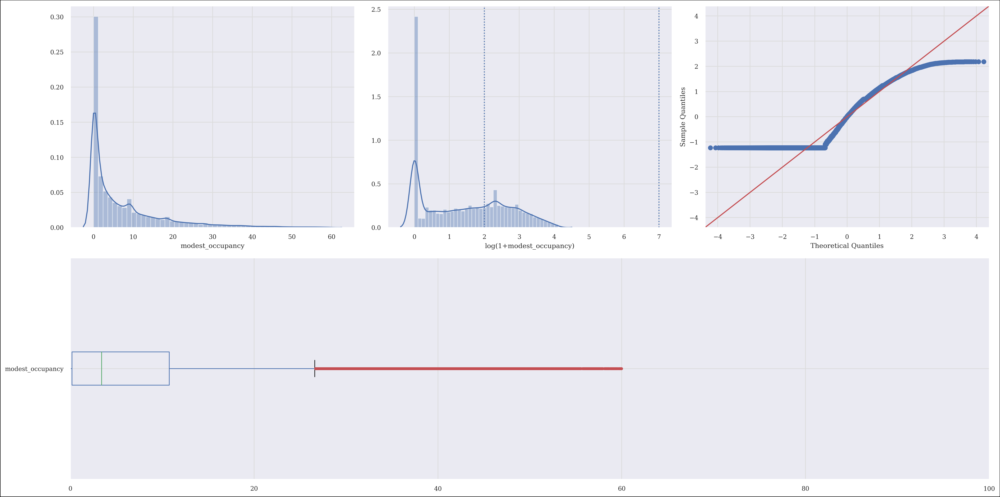

In [45]:
plt.figure(num=1, figsize=(20,10), linewidth=1)
# plot distribution of price
plt.subplot2grid((2, 3), (0, 0))
sns.distplot(df['modest_occupancy'])
# plot distribution of log(1+price)
plt.subplot2grid((2, 3), (0, 1))
sns.distplot(np.log1p(df['modest_occupancy']))
plt.axvline(x=2, color='b', linestyle=':')
plt.axvline(x=7, color='b', linestyle=':')
plt.xlabel('log(1+modest_occupancy)')
## plot qqplot of distribution of log(1+price)
ax = plt.subplot2grid((2, 3), (0, 2))
sm.qqplot(np.log1p(df['modest_occupancy']), stats.norm, fit=True, line='45', ax=ax);

# boxplot of price column
plt.subplot2grid((2, 3), (1, 0), colspan=3)
red = dict(markerfacecolor='r', markeredgecolor='r', marker='.')
df.modest_occupancy.plot(kind='box', xlim=(0, 100), vert=False, flierprops=red)

plt.tight_layout();

In [58]:
# inverse of log transformed prices
occupancy_outliers = df[(np.log1p(df['modest_occupancy']) < 1) | (np.log1p(df['modest_occupancy']) > 4)]
print(f'Number of listings which are assumed as outliers: {len(occupancy_outliers)}\n')
print(f'Outlier occupancy range: {np.exp(1) - 1} and {np.exp(4) - 1}')

Number of listings which are assumed as outliers: 34225

Outlier occupancy range: 1.718281828459045 and 53.598150033144236


In [59]:
occupancy_outliers = df[(np.log1p(df['modest_occupancy']) < 1) | (np.log1p(df['modest_occupancy']) > 4)]
occupancy_outlier_filter = df.index.isin(occupancy_outliers.index)

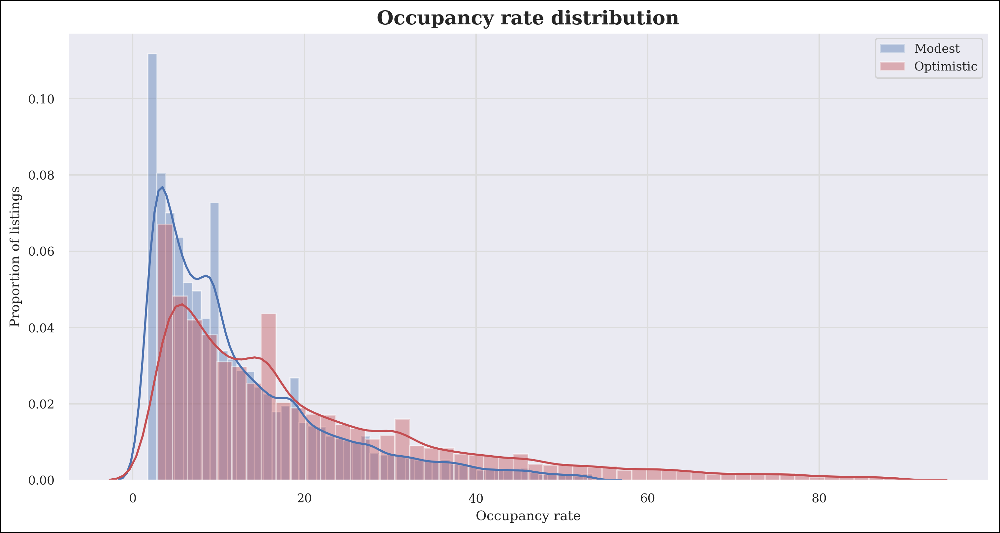

In [60]:
fig, ax = plt.subplots(figsize=(12, 6), linewidth=1)
# plot average occupancy estimate by Boroughs
sns.distplot(df[~occupancy_outlier_filter].modest_occupancy, kde=True, label='Modest', color='b', ax=ax)
sns.distplot(df[~occupancy_outlier_filter].optimistic_occupancy, kde=True, label='Optimistic', color='r', ax=ax)
plt.title("Occupancy rate distribution", fontdict=dict(fontsize=14, fontweight='bold'))
plt.xlabel('Occupancy rate')
plt.ylabel('Proportion of listings')
_ = plt.legend()

plt.savefig('charts/dist_occupancy_rate.png')

In [54]:
df[~occupancy_outlier_filter].optimistic_occupancy.describe()

count    50430.000000
mean        20.517675
std         17.316320
min          2.910000
25%          7.510000
50%         15.330000
75%         28.210000
max         89.240000
Name: optimistic_occupancy, dtype: float64

## Location of Listings

In [274]:
# plot heatmap of neighbourhood listings
hmap = plot_folium_heatmap(df.latitude, df.longitude)
display(hmap)
hmap.save('charts/listings_location_map.html')

## Rent affordability

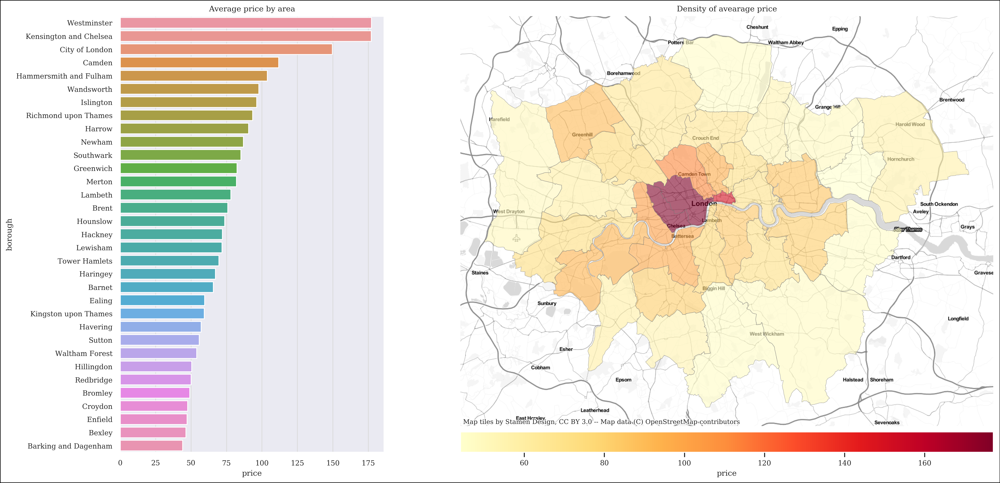

In [80]:
g2 = df.groupby(['borough'])['price'].mean().reset_index()

# add geometry attribute 
g2_map = geo_df.merge(g2, on='borough').sort_values(ascending=False, by='price')

fig, ax = plt.subplots(figsize=(20, 10), linewidth=1)
# plot average occupancy estimate by Boroughs
ax1 = plt.subplot2grid((2, 3), (0, 0), rowspan=2, fig=fig)
sns.barplot(x='price', y='borough', data=g2_map, ax=ax1)
_ = ax1.set_title("Average price by area")

# plot choropleth map to show availability
ax2 = plt.subplot2grid((2, 3), (0, 1), rowspan=2, colspan=2, fig=fig)
_ = plot_choropleth_map(
    g2_map, 'price', 'Density of avearage price', 
    ax=ax2, legend_label="price"
)

In [90]:
outlier_filter = df.index.isin(outliers.index)

In [100]:
df_prices = df[['modest_occupancy', 'price']]
df_prices.iloc[:, 1:] = StandardScaler().fit_transform(df_prices.iloc[:, 1:])
df_prices

,modest_occupancy,price
0,14.63,-0.094627
1,1.29,-0.146215
2,6.72,-0.067712
3,3.68,0.380876
4,7.91,0.100508
...,...,...
85268,0.00,-0.101356
85269,0.00,-0.213503
85270,0.00,0.650028
85271,0.00,-0.213503


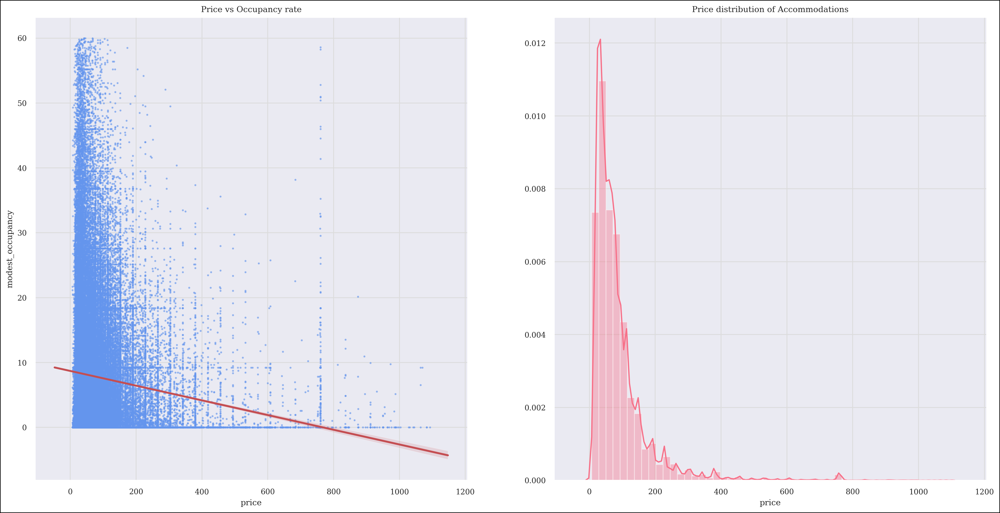

In [102]:
# plot price distribution of prices
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10), linewidth=1, sharex=True)

sns.regplot(x="price", y="modest_occupancy", data=df.loc[~outlier_filter], color='cornflowerblue', 
            scatter_kws=dict(s=2, alpha=0.5), line_kws=dict(color='r'), ax=ax1
)
# sns.barplot(x='price', y='borough', data=g2_map, ax=ax2)
_ = ax1.set_title("Price vs Occupancy rate")


sns.distplot(df.loc[~outlier_filter].price, ax=ax2)
_= ax2.set_title('Price distribution of Accommodations')

plt.savefig('charts/price_distribution.png')

## Demand by Neighbourhood 

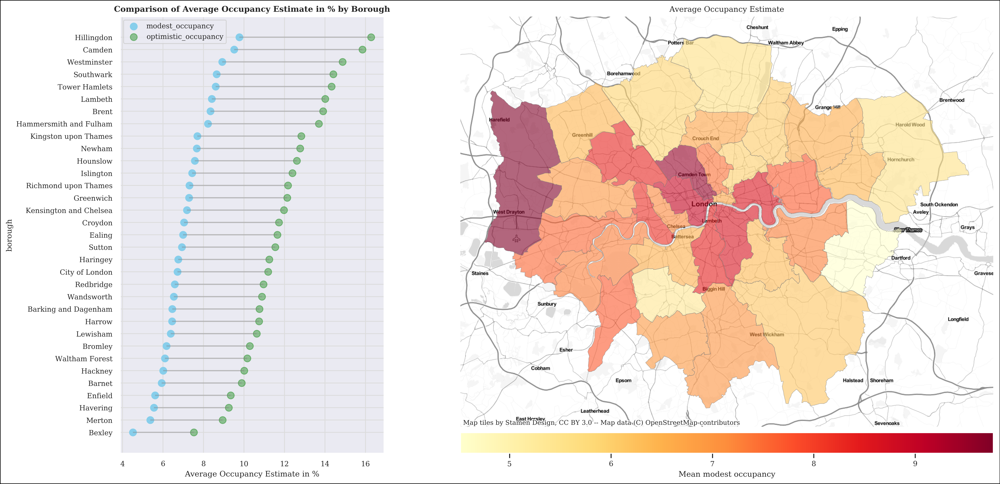

In [276]:
g1 = df.groupby(['borough'])['modest_occupancy'].mean().reset_index()

fig, ax = plt.subplots(figsize=(20, 10), linewidth=1)
# plot average occupancy estimate by Boroughs
ax1 = plt.subplot2grid((2, 3), (0, 0), rowspan=2, fig=fig)

plot_lollipop('modest_occupancy', 'optimistic_occupancy', 'borough',
              'Average Occupancy Estimate in %', df, ax=ax1, show=False)

# add geometry attribute 
g1_map = geo_df.merge(g1, on='borough').sort_values(ascending=False, by='modest_occupancy')

# plot choropleth map to show availability
ax2 = plt.subplot2grid((2, 3), (0, 1), rowspan=2, colspan=2, fig=fig)
_ = plot_choropleth_map(
    g1_map, 'modest_occupancy', 'Average Occupancy Estimate', 
    basemap=True, ax=ax2, legend_label="Mean modest occupancy"
)
plt.savefig('charts/occupancy_by_neighbourhood.png')

At the topmost is Hillingdon, which is not surprising since Heathrow airport is near the south end of London borough of Hillingdon.

In [277]:
# Now let find out the price distribution of the top 10 Boroughs
borough_table = []
# create a subset using the outlier filter
top_10_boroughs = df['borough'].value_counts().index[:10]
for b in top_10_boroughs:
    borough_table.append(df[df['borough'] == b]['modest_occupancy'].describe().T)

# print table
pd.DataFrame(borough_table, index=df['borough'].value_counts().index[:10]).sort_values(by='mean')

,count,mean,std,min,25%,50%,75%,max
Hackney,6213.0,6.008432,8.906279,0.0,0.18,2.300,8.10,59.80
Wandsworth,4331.0,6.534064,9.275498,0.0,0.00,2.670,9.20,59.43
Kensington and Chelsea,5992.0,7.184327,9.561012,0.0,0.00,3.635,10.30,58.70
Islington,5102.0,7.433516,9.999570,0.0,0.28,3.220,10.49,59.80
Hammersmith and Fulham,4162.0,8.216576,10.192666,0.0,0.37,4.420,12.05,59.06
Lambeth,4798.0,8.409123,11.172538,0.0,0.46,3.860,11.68,59.98
Tower Hamlets,8130.0,8.596392,11.337324,0.0,0.28,3.770,12.42,59.80
Southwark,4839.0,8.644933,11.257903,0.0,0.46,4.050,12.51,59.34
Westminster,9728.0,8.922094,11.058589,0.0,0.00,4.880,13.25,59.98
Camden,5897.0,9.513517,11.949169,0.0,0.55,5.060,13.62,58.60


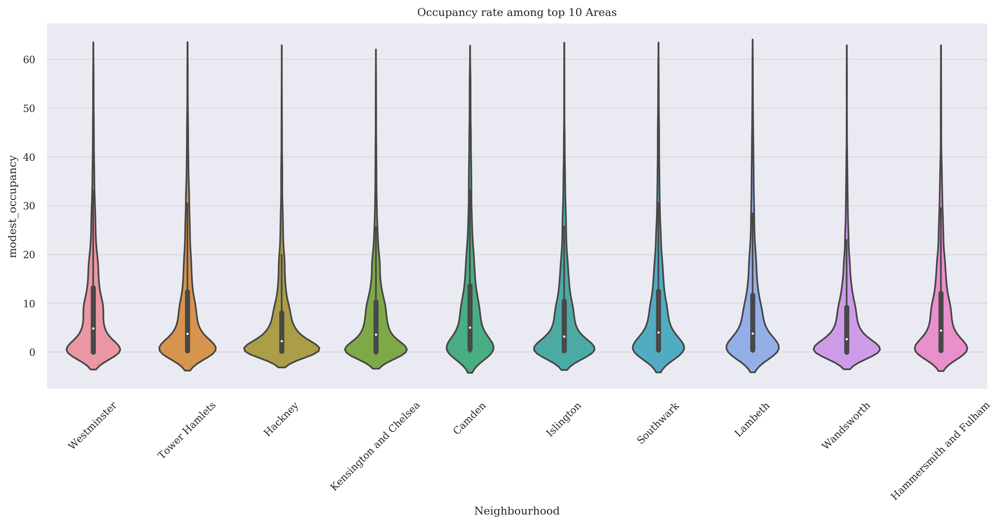

In [278]:
# Let's visualize the above table using violin plots
plt.figure(num=2, figsize=(15,6))
fig_2 = sns.violinplot(x='borough', y='modest_occupancy', data=df, order=top_10_boroughs)
_ = fig_2.set_title("Occupancy rate among top 10 Areas")
_ = fig_2.set_xlabel("Neighbourhood")
_ = plt.xticks(rotation=45)

## Income Estimates

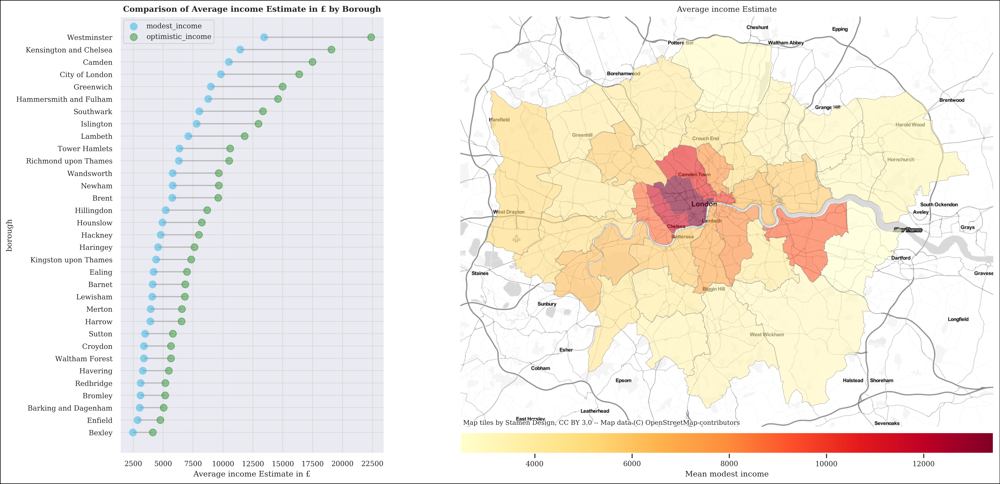

In [289]:
fig, ax = plt.subplots(figsize=(20, 10), linewidth=1)

# plot average income estimate by Boroughs
ax1 = plt.subplot2grid((2, 3), (0, 0), rowspan=2, fig=fig)
plot_lollipop('modest_income', 'optimistic_income', 'borough', 
              'Average income Estimate in £', df, ax=ax1, show=False)

# group by neighbourhood then take the median income
g4 = df.groupby(['borough'])['modest_income'].mean().reset_index()
# add geometry attribute 
g4_map = geo_df.merge(g4, on='borough').sort_values(ascending=False, by='modest_income')
# plot choropleth map to show availability
ax2 = plt.subplot2grid((2, 3), (0, 1), rowspan=2, colspan=2, fig=fig)
_ = plot_choropleth_map(
    g4_map, 'modest_income', 'Average income Estimate', 
    basemap=True, ax=ax2, legend_label="Mean modest income"
)
plt.savefig('charts/income_estimates.png')

### Demand by Capacity

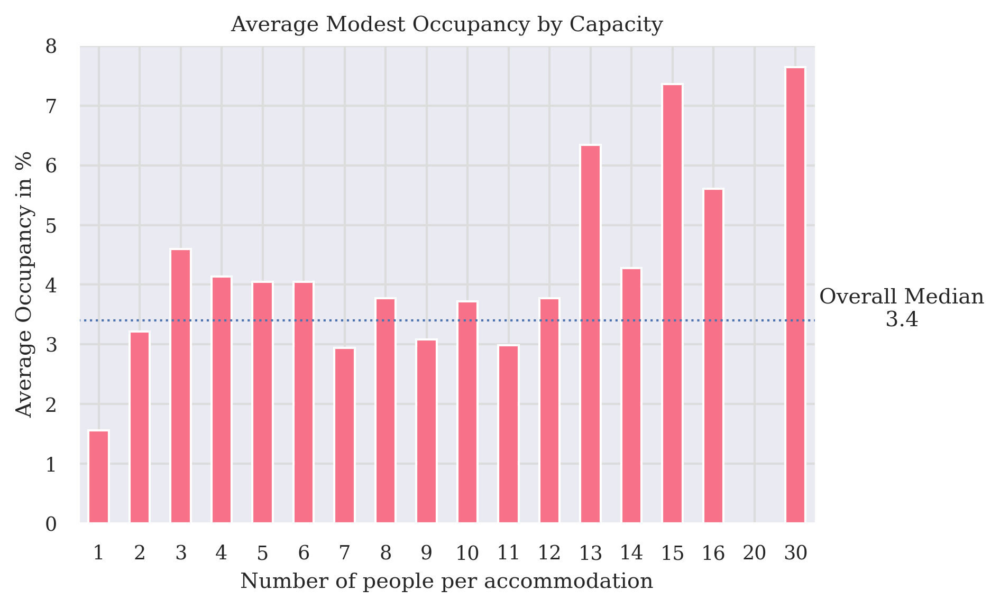

In [79]:
# group by accomodates and plot median occupancy
g6 = df.groupby(['accommodates'])['modest_occupancy'].median()
overral_median = df.modest_occupancy.median()
# make a bar plot
g6.plot(kind='bar', figsize=(6,4))

# label the plot
plt.xlabel('Number of people per accommodation')
plt.xticks(rotation='horizontal')
plt.ylabel('Average Occupancy in %')
plt.title('Average Modest Occupancy by Capacity')

# draw and label the median value
plt.axhline(y=overral_median, xmin=0, xmax=1, linewidth=1, linestyle=':', color='b')
plt.text(x=19.6, y=overral_median - 0.1, s=f'Overall Median\n{overral_median}', ha='center');
plt.savefig('charts/occupancy_by_capacity.png')

Generally, bigger homes seem to be sold more often than smaller ones.

## Occupancy by Amenities

In [62]:
# create a counter to count amentities in the dataset
results = Counter()
df.amenities.apply(results.update)
# create a new sub dataframe with 'amenity' and 'count'
amenity_df = pd.DataFrame(results.most_common(20), columns=['amenity', 'count'])
amenity_df.head()

,amenity,count
0,Wifi,81363
1,Heating,79426
2,Essentials,78892
3,Kitchen,77551
4,Smoke detector,72352


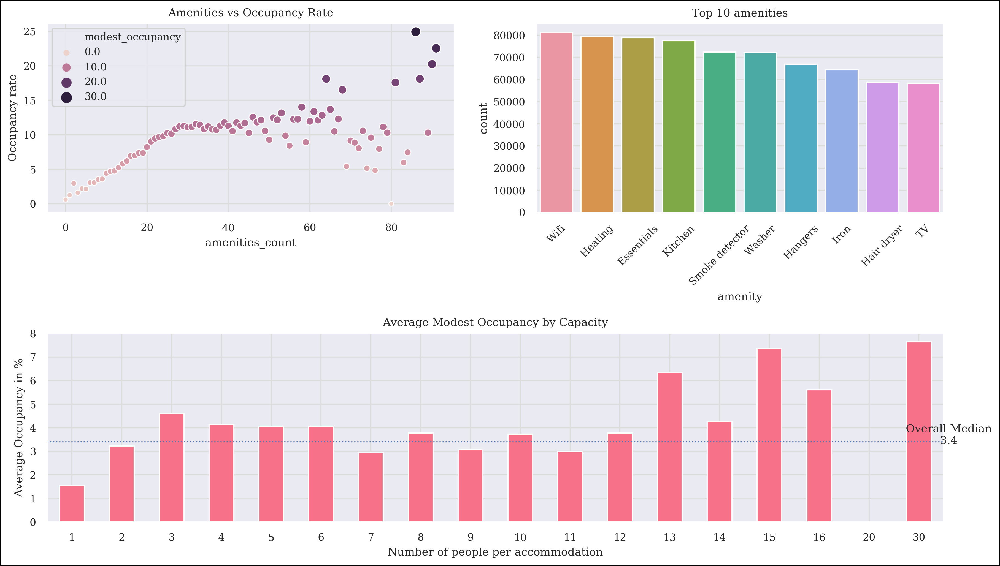

In [77]:
# group by neighbourhood and by status, then take the median income
g2 = df.groupby(['amenities_count'])['modest_occupancy'].mean().reset_index()

# create subplot figure
fig, ax = plt.subplots(figsize=(14, 8), linewidth=1)
# plot amentity count
ax1 = plt.subplot2grid((5, 2), (0, 0), fig=fig, rowspan=2)
sns.scatterplot(x='amenities_count', y='modest_occupancy', data=g2, ax=ax1, 
                size='modest_occupancy', hue='modest_occupancy')
_ = ax1.set_title("Amenities vs Occupancy Rate")
plt.ylabel('Occupancy rate')

# plot top amentities
ax2 = plt.subplot2grid((5, 2), (0, 1), fig=fig, rowspan=2)
sns.barplot(y='count', x='amenity', data=amenity_df, ax=ax2, order=amenity_df.amenity[:10])
_ = ax2.set_title("Top 10 amenities")
plt.sca(ax2)
_= plt.xticks(rotation=45)


ax3 = plt.subplot2grid((5, 2), (3, 0), fig=fig, colspan=2, rowspan=2)
g6.plot(kind='bar', ax=ax3)
# label the plot
plt.sca(ax3)
plt.xlabel('Number of people per accommodation')
plt.xticks(rotation='horizontal')
plt.ylabel('Average Occupancy in %')
plt.title('Average Modest Occupancy by Capacity')

# draw and label the median value
plt.axhline(y=overral_median, xmin=0, xmax=1, linewidth=1, linestyle=':', color='b')
plt.text(x=17.6, y=overral_median - 0.1, s=f'Overall Median\n{overral_median}', ha='center');

plt.savefig('charts/amentities_vs_occupancy.png')

## Occupancy by Price

In [70]:
outliers = df[(np.log1p(df['price']) < 2) | (np.log1p(df['price']) > 7)]
outlier_filter = df.index.isin(outliers.index)

<Figure size 2400x1200 with 0 Axes>

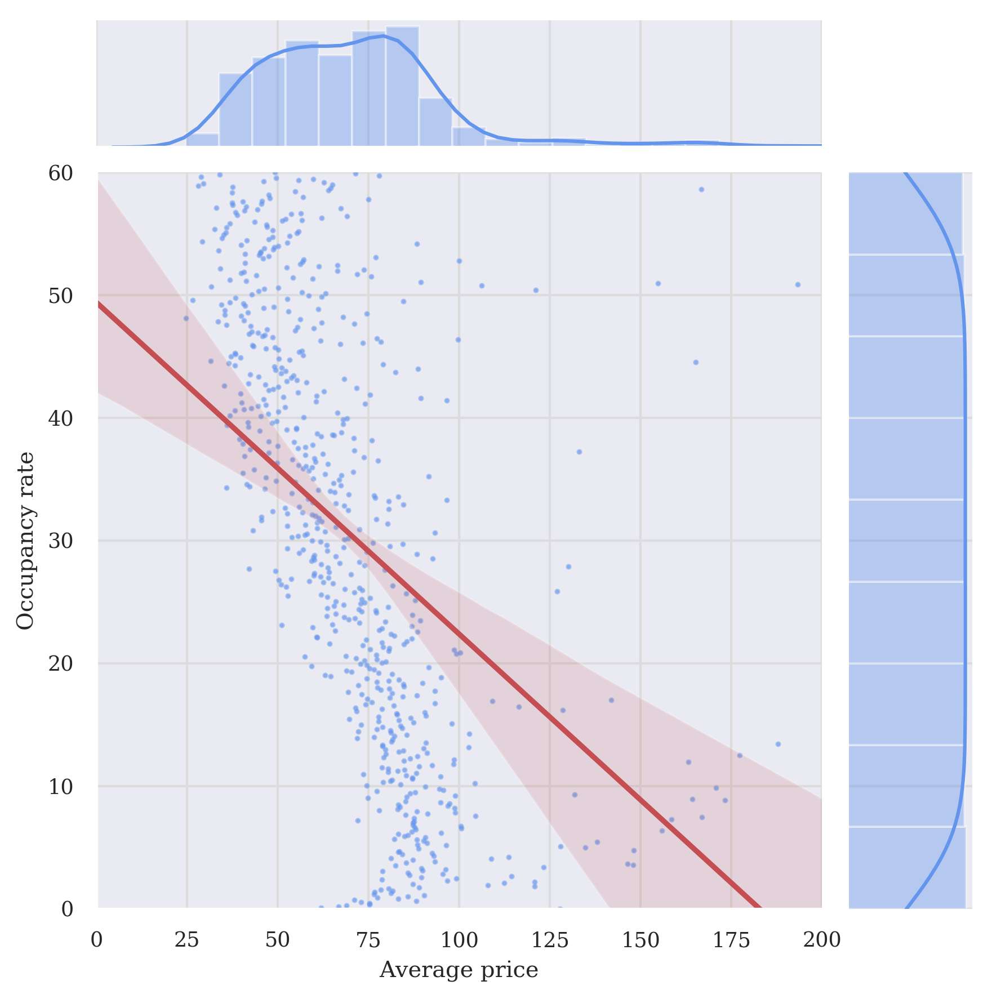

In [73]:
g3 = df.groupby(['modest_occupancy'])['price'].mean().reset_index()

plt.figure(num=2, figsize=(8,4), linewidth=1)
sns.jointplot(x="price", y="modest_occupancy", data=g3, color='cornflowerblue', 
                    kind='reg', scatter_kws=dict(s=2, alpha=0.5), line_kws=dict(color='r')
                   )
plt.xlim(0, 200)
plt.ylim(0, g3.modest_occupancy.max())
plt.ylabel('Occupancy rate')
plt.xlabel('Average price')
plt.savefig('charts/price_vs_occupancy.png')

## Occupancy vs Sentiment

In [136]:
g8 = df[(~occupancy_outlier_filter) & (df.description_count != 0) & (df.summary_count !=0)].groupby(
    ['summary_sentiment_score', 'description_sentiment_score'])['modest_occupancy'].mean().reset_index()
g8

,summary_sentiment_score,description_sentiment_score,modest_occupancy
0,-0.525000,0.054590,36.800000
1,-0.500000,-0.500000,11.320000
2,-0.340000,-0.004167,18.400000
3,-0.305556,-0.305556,9.200000
4,-0.300000,-0.300000,16.436667
...,...,...,...
43254,1.000000,0.440000,3.500000
43255,1.000000,0.484411,5.060000
43256,1.000000,0.500000,8.560000
43257,1.000000,0.575333,2.120000


<Figure size 3600x1200 with 0 Axes>

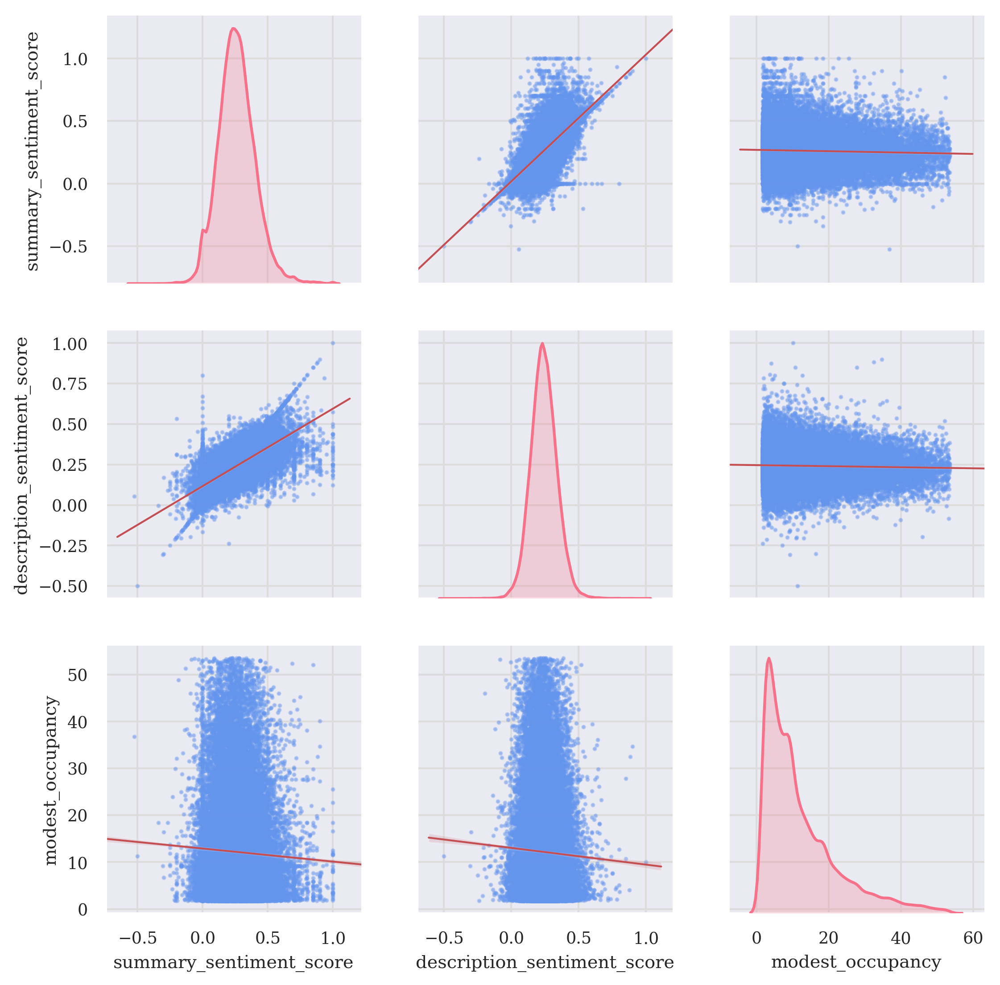

In [138]:
plt.figure(figsize=(12,4), linewidth=1)

sns.pairplot(g8, vars=['summary_sentiment_score', 'description_sentiment_score', 'modest_occupancy'],
            diag_kind='kde', palette="husl", 
             plot_kws=dict(line_kws=dict(color='r', linewidth=1), color='cornflowerblue', scatter_kws=dict(marker='o', s=2, alpha=0.4)), 
             kind='reg',
            )
plt.savefig("charts/occupancy_vs_sentiments.png")

## Correlation between features

In [105]:
df.head()

,name,experiences_offered,borough,latitude,longitude,accommodates,bathrooms,bedrooms,beds,bed_type,...,reviews_per_month,amenities_count,summary_count,summary_sentiment_score,description_count,description_sentiment_score,average_sentiment,modest_occupancy,optimistic_occupancy,sentiment
0,"[Arty, Bright, London, Apartment, Zone, 2]",family,Lambeth,51.46225,-0.11732,4,1.0,1.0,1.0,Real Bed,...,1.59,22,88,0.234377,172,0.198060,0.22,14.63,24.38,positive
1,"[Holiday, London, DB, Room, Let-on, going]",business,Islington,51.56802,-0.11121,2,1.0,1.0,0.0,Real Bed,...,0.14,54,52,0.423452,185,0.346639,0.39,1.29,2.15,positive
2,"[Bright, Chelsea, Apartment, Chelsea]",romantic,Kensington and Chelsea,51.48796,-0.16898,2,1.0,1.0,1.0,Real Bed,...,0.73,28,46,-0.020833,177,0.158571,0.07,6.72,11.19,positive
3,"[Superb, 3-Bed/2, Bath, Wifi, Trendy, W1]",none,Westminster,51.52098,-0.14002,6,2.0,3.0,4.0,Real Bed,...,0.40,30,52,0.500000,161,0.343737,0.42,3.68,6.13,positive
4,"[Battersea, bedroom, office, w, parking, share...",family,Wandsworth,51.47298,-0.16376,2,1.5,1.0,1.0,Real Bed,...,0.86,26,79,0.084560,170,0.028192,0.06,7.91,13.19,positive


In [148]:
numeric_features = ['accommodates', 'bathrooms', 'bedrooms', 'price', 'amenities_count',
            'popularity_index', 'summary_count', 'summary_sentiment_score', 'description_count', 'description_sentiment_score',
            'cleaning_fee', 'availability_365', 'beds', 'optimistic_occupancy', 'modest_occupancy', 
           ]
# standardize numerical attribute using zscore
corr_df = df[numeric_features]
scaled_values = StandardScaler().fit_transform(corr_df)
corr_df.loc[:,numeric_features] = scaled_values

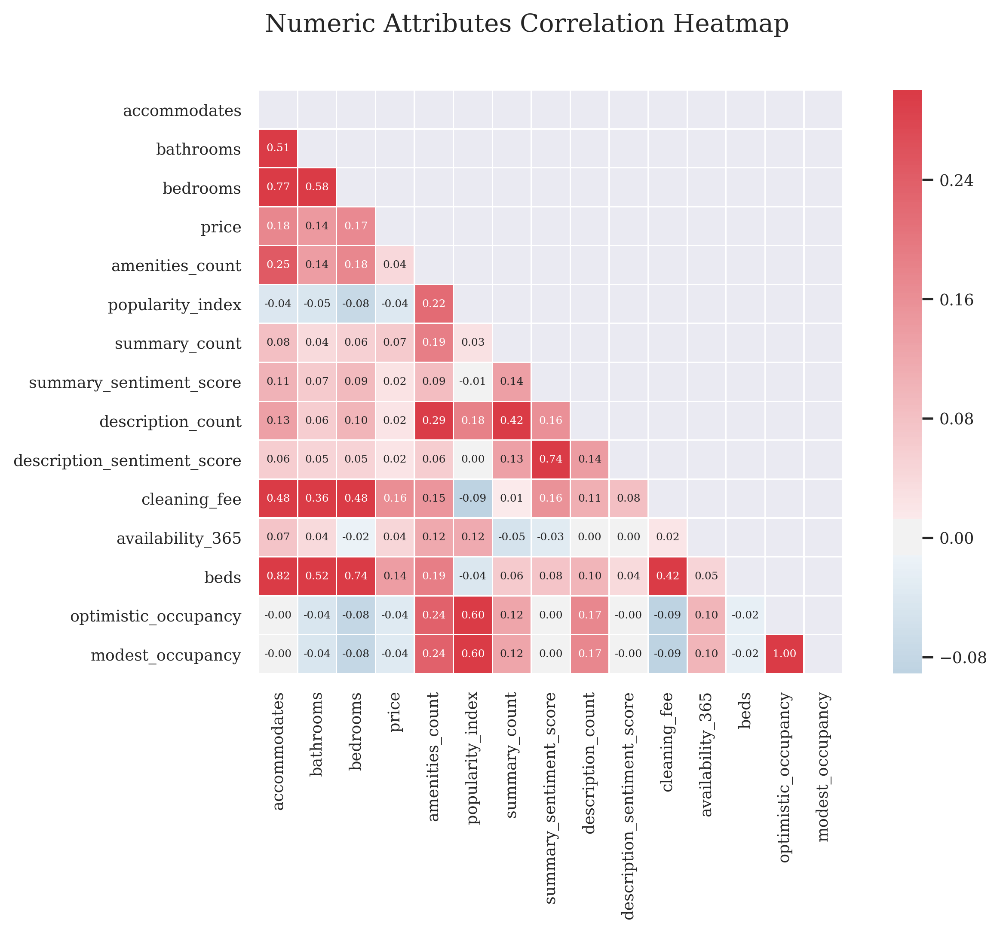

In [149]:
fig, ax = plt.subplots(figsize=(10, 6))
# first normalize values and calculate correlation using pearson correlation.
corr = corr_df.corr()

# generate a mask for the upper triangle
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

# generate a custom diverging colormap
cmap = sns.diverging_palette(240, 10, as_cmap=True)

# draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, fmt='.2f', annot=True, 
            annot_kws={"size": 6}, ax=ax,
           )
t = fig.suptitle('Numeric Attributes Correlation Heatmap', fontsize=14)
plt.savefig('charts/correlation.png')

# Linear regression

In [139]:
## define regressors
cat_columns = ['host_is_superhost', 'room_type', 'instant_bookable','cancellation_policy', 'bed_type']
regressors = cat_columns + [
    'accommodates', 'bathrooms', 'bedrooms', 'price', 'amenities_count',
    'popularity_index', 'summary_count', 'summary_sentiment_score', 'description_count', 
    'description_sentiment_score', 'cleaning_fee', 'availability_365',
    'review_scores_accuracy', 'review_scores_cleanliness', 'beds',
    'review_scores_checkin', 'review_scores_communication', 'review_scores_location',
]
# define targe variable
target = ['modest_occupancy']

# define regression data
# we'll remove all outliers from the dataset to improve the performance of the model.
reg_df = df.loc[:, regressors+target]

# normalize dataset using zscore
reg_df.iloc[:, 5:] = StandardScaler().fit_transform(reg_df.iloc[:, 5:])
# using Multiple Linear Regression with the following formula
# Y = C + M1 * X1 + M2 * X2 + ...Mn *Xn
# Where:
# Y = Dependent variable (output/outcome/prediction/estimation)
# C = Constant (Y-Intercept)
# M = Slope of the regression line (the effect that X has on Y)
# X = Independent variable (input variable used in the prediction of Y)

formula = f'{target[0]} ~ {" + ".join(regressors)}'
print(f"Regression formula: \n{formula}")

Regression formula: 
modest_occupancy ~ host_is_superhost + room_type + instant_bookable + cancellation_policy + bed_type + accommodates + bathrooms + bedrooms + price + amenities_count + popularity_index + summary_count + summary_sentiment_score + description_count + description_sentiment_score + cleaning_fee + availability_365 + review_scores_accuracy + review_scores_cleanliness + beds + review_scores_checkin + review_scores_communication + review_scores_location


In [140]:
## Fit the model
model = sm.formula.ols(formula=formula, data=reg_df, hasconst=False).fit()
# display summary 
print(model.summary())

                                 OLS Regression Results                                
Dep. Variable:       modest_occupancy   R-squared (uncentered):                   0.478
Model:                            OLS   Adj. R-squared (uncentered):              0.478
Method:                 Least Squares   F-statistic:                              2586.
Date:                Thu, 19 Dec 2019   Prob (F-statistic):                        0.00
Time:                        20:39:58   Log-Likelihood:                         -92578.
No. Observations:               84655   AIC:                                  1.852e+05
Df Residuals:                   84625   BIC:                                  1.855e+05
Df Model:                          30                                                  
Covariance Type:            nonrobust                                                  
                                      coef    std err          t      P>|t|      [0.025      0.975]
--------------------

In [141]:
# lets output the standard measures from the model to check the performance
print("R-squared:",model.rsquared)
print("MSE model:",model.mse_model)
print("MSE residuals:",model.mse_resid)
print("MSE total:",model.mse_total)

# test of normality of the residuals:
name = ['Jarque-Bera', 'Chi^2 two-tail prob.', 'Skew', 'Kurtosis']
jarque_test, _, _, _ = sms.jarque_bera(model.resid)
print(f'\nThe Jarque-Bera test of normality is {jarque_test}')

# Test linearity using Rainbow test
name = ['f-statistic', 'p-value']
f_statistic, p_value = sms.linear_rainbow(model)
print(f'\nThe Rainbow test of linearity has a statistic of {f_statistic} and a p-value of {p_value}.')

R-squared: 0.4783150072979534
MSE model: 1349.725231426942
MSE residuals: 0.5218699327290017
MSE total: 1.0000000000000004

The Jarque-Bera test of normality is 225625.2681156132

The Rainbow test of linearity has a statistic of 3.158724815567208 and a p-value of 0.0.


In [142]:
def get_coef_table(lin_reg):
    ''' lin_reg is a fitted statsmodels regression model
    Return a dataframe containing coefficients, pvalues, and the confidence intervals
    https://gist.github.com/zhiyzuo/972b8b95e115c44d6805c929b7b4e2ca
    '''
    err_series = lin_reg.params - lin_reg.conf_int()[0]
    coef_df = pd.DataFrame({
        'varname': err_series.index.values[1:],
        'coef': lin_reg.params.values[1:],
        'ci_err': err_series.values[1:],
        'pvalue': lin_reg.pvalues.round(4).values[1:],                        
    })
    return coef_df

coef_df = get_coef_table(model)

x = coef_df.loc[:, ['coef']]
coef_df['colors'] = ['red' if x < 0 else 'green' for x in coef_df['coef']]
coef_df.sort_values('coef', inplace=True)
coef_df.reset_index(inplace=True)

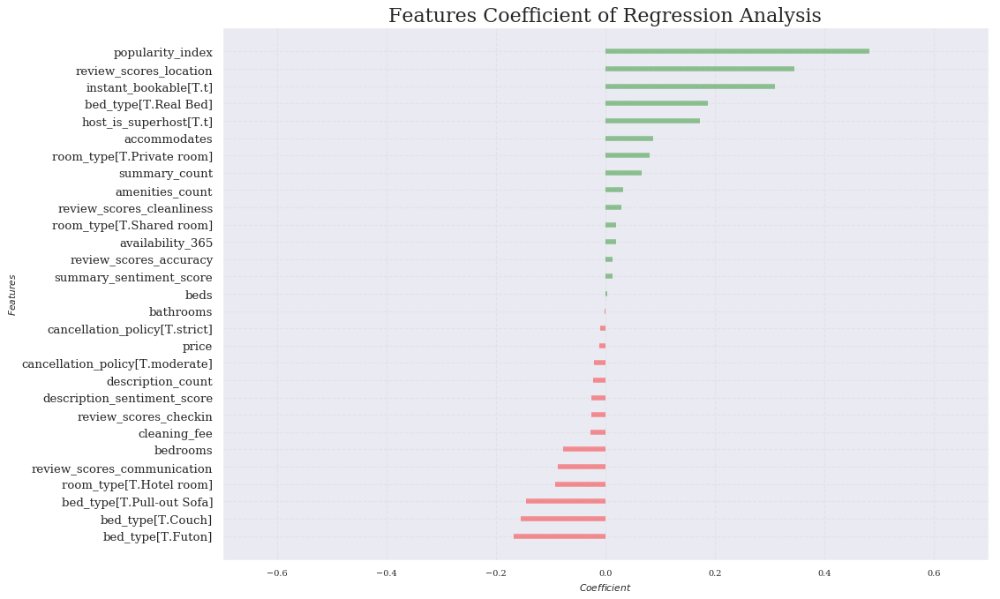

<Figure size 1800x1200 with 0 Axes>

In [143]:
# Visualize coefficient
plt.figure(figsize=(14,10), dpi= 80)
plt.hlines(y=coef_df.index, xmin=0, xmax=coef_df.coef, color=coef_df.colors, alpha=0.4, linewidth=5)
plt.xlim(-0.7, 0.7)

# labels
plt.gca().set(ylabel='$Features$', xlabel='$Coefficient$')
plt.yticks(coef_df.index, coef_df.varname, fontsize=12)
plt.title('Features Coefficient of Regression Analysis', fontdict={'size':20})
plt.grid(linestyle='--', alpha=0.5)
plt.show()
plt.savefig('charts/regression_cooefficient.png')

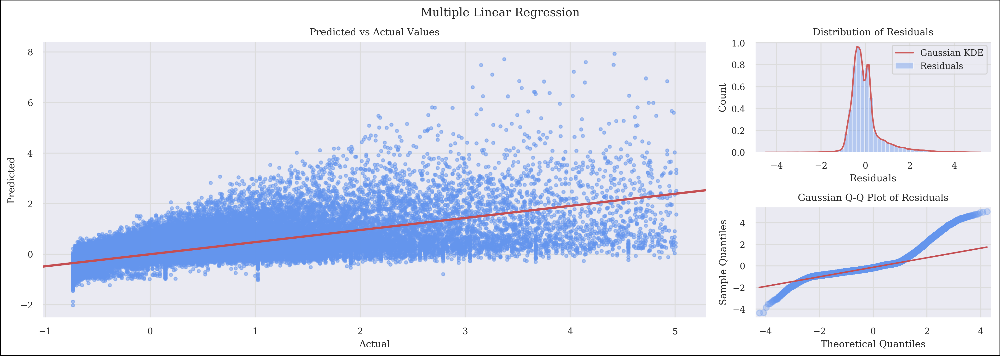

In [144]:
# let's visualize regression results
plt.figure(figsize=(14,5), linewidth=1)

# make predictions
preds = model.predict(reg_df)
# Plot Actual vs Predicted scatterplot
plt.subplot2grid((2,7), (0,0), rowspan=2, colspan=5)
sns.regplot(reg_df.modest_occupancy, preds,  color='cornflowerblue', 
            scatter_kws=dict(alpha=.5, s=10), line_kws=dict(color='r'))
plt.xlabel('Actual'), 
plt.ylabel('Predicted')
plt.title('Predicted vs Actual Values')

## Plot Distribution of Residuals
plt.subplot2grid((2,7), (0,5), rowspan=1, colspan=2)
sns.distplot(reg_df.modest_occupancy-preds,
             hist_kws={'color':'cornflowerblue', 'label':'Residuals'}, 
             kde_kws={'color':'indianred', 'label':'Gaussian KDE'})
plt.xlabel('Residuals'), plt.ylabel('Count')
plt.title('Distribution of Residuals')
plt.legend()

## Plot Q-Q Plot
ax = plt.subplot2grid((2,7), (1,5), rowspan=1, colspan=2)
sm.qqplot(reg_df.modest_occupancy-preds, ax=ax, line='q', color='cornflowerblue', alpha=.3)
plt.title('Gaussian Q-Q Plot of Residuals')

plt.suptitle('Multiple Linear Regression')
plt.tight_layout(rect=[0,0,1,.95])
plt.savefig('charts/regression.png')

# Word cloud

In [205]:
text = " ".join(" ".join(name) for name in df.name)

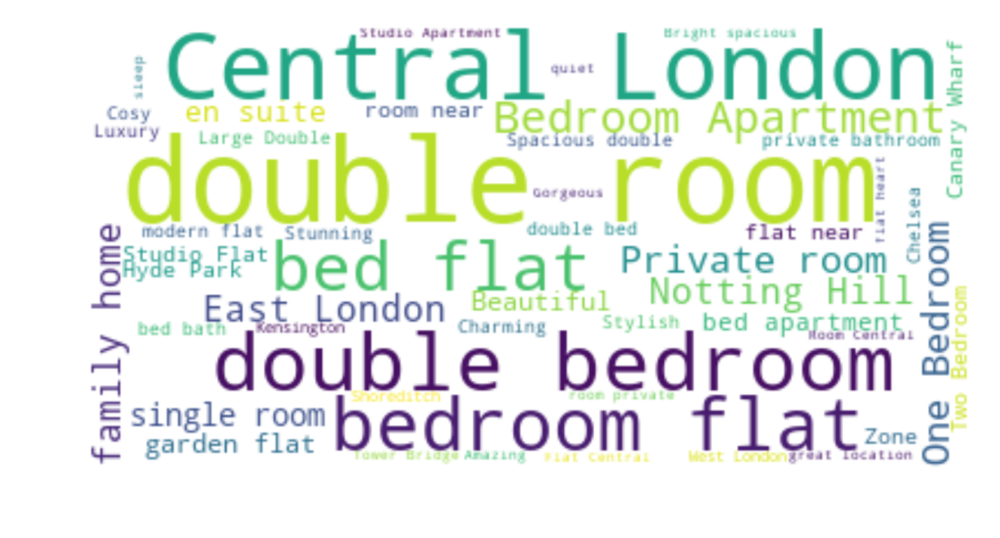

In [214]:
# Generate a word cloud image
stopwords = set(STOPWORDS)
stopwords.update([])

wordcloud = WordCloud(stopwords=stopwords, background_color="white", max_words=50).generate(text)

# Display the generated image:
# the matplotlib way:
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

We can observe that finding out and going over top 25 used listings' name words - we are able to see one clear trend. It shows that hosts are simply describing their listing in a short form with very specific terms for easier search by a potential traveler. Such wors are 'room', 'bedroom', 'private', 'apartment', 'studio'. This shows that there are no catchphrases or 'popular/trending' terms that are used for names; hosts use very simple terms describing the space and the area where the listing is. This technique was somewhat expected as dealing with multilingual customers can be tricky and you definitely want to describe your space in a concise and understood form as much as possible.

In [215]:
#we are going to use counter
from collections import Counter

In [222]:
result = Counter()

In [226]:
df.name = df.name.apply(lambda name: [x for x in name if len(x) > 2])

In [227]:
df.name.apply(result.update)

0        None
1        None
2        None
3        None
4        None
         ... 
85268    None
85269    None
85270    None
85271    None
85272    None
Name: name, Length: 84655, dtype: object

In [239]:
keywords_count = result.most_common(10)

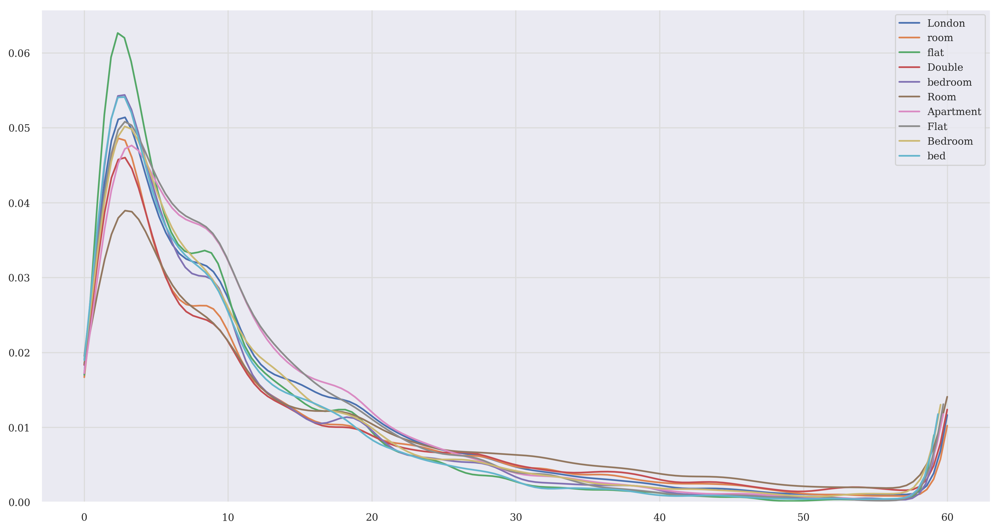

In [241]:
#Plotting different tweet types on same distribution
plt.figure(figsize=(15,8))
#sns.kdeplot(df.msgdate_h, label="Totals")
for key in keywords_count:
    sns.kdeplot(df[[key[0] in x for x in df['name']]].modest_occupancy, label=key[0], cut=0)

plt.legend()

In [232]:
keywords_count[0][0]

'London'

# Clustering

In [145]:
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

In [146]:
df.columns

Index(['name', 'experiences_offered', 'host_is_superhost', 'borough',
       'latitude', 'longitude', 'room_type', 'accommodates', 'bathrooms',
       'bedrooms', 'beds', 'bed_type', 'amenities', 'price', 'cleaning_fee',
       'availability_365', 'review_scores_accuracy',
       'review_scores_cleanliness', 'review_scores_checkin',
       'review_scores_communication', 'review_scores_location',
       'instant_bookable', 'cancellation_policy', 'reviews_per_month',
       'amenities_count', 'summary_count', 'summary_sentiment_score',
       'description_count', 'description_sentiment_score', 'average_sentiment',
       'sentiment', 'modest_occupancy', 'optimistic_occupancy',
       'modest_income', 'optimistic_income', 'popularity_index'],
      dtype='object')

In [304]:
pca = PCA(n_components = 2)
pca.fit(df[numeric_features])
df_pca = pca.transform(df[numeric_features])

print('Explained variance ratio \n   Total :', round(pca.explained_variance_ratio_.sum()*100, 2), '%',
      '\n   By principal component :', pca.explained_variance_ratio_, '\n');

Explained variance ratio 
   Total : 96.02 % 
   By principal component : [0.82933074 0.13091435] 



### Determine cluster number by Elbow Method

In [477]:
from scipy.spatial.distance import cdist
df_clustering = df[~outlier_filter][numeric_features]

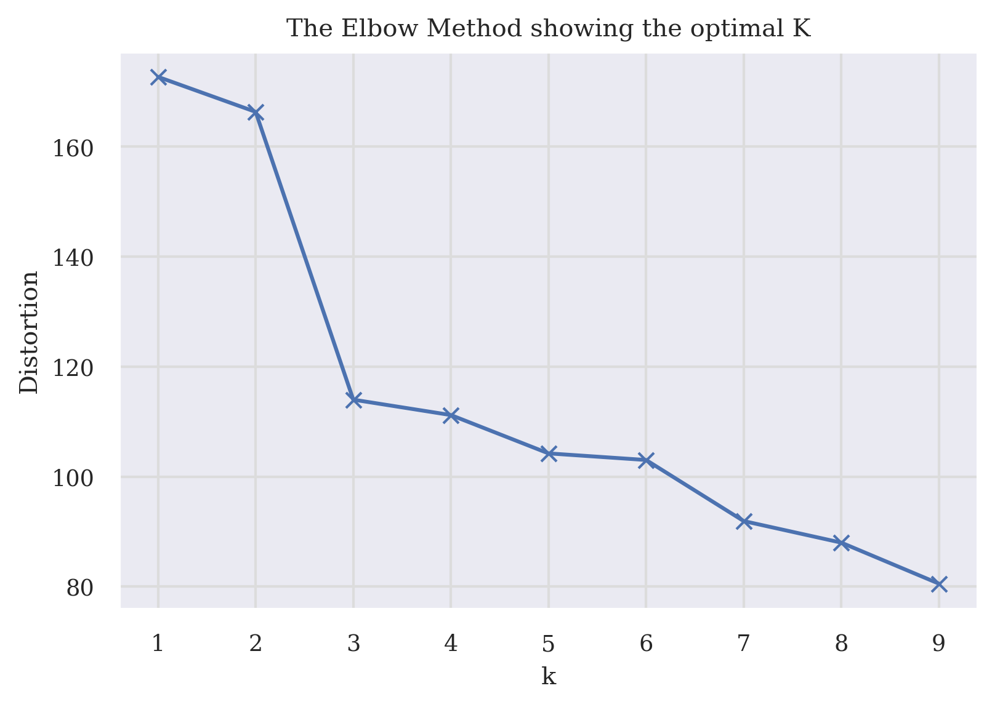

In [317]:
K = range(1,10)
distortions = []
for k in K:
    kmeans = KMeans(init = 'k-means++', n_clusters = k, n_init = 12, random_state = 0)
    kmeans.fit(df_clustering)
    distortions.append(sum(np.min(cdist(df_clustering, kmeans.cluster_centers_, 'euclidean'), axis = 1)) / df_clustering.shape[0])

plt.plot(K, distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortion')
plt.title('The Elbow Method showing the optimal K')
plt.show()           

In [484]:
# Now let's try to cluster the data using kmeans before visualizing
n_clusters = 6 # Change this value to experiment with different numbers of clusters
kmeans = KMeans(n_clusters=n_clusters)

# Fitting the algorithm to the data
kmeans = kmeans.fit(df_clustering)

# Getting the Cluster labels for the dataframe
cluster_labels = kmeans.predict(df_clustering)

# Getting the Centroid values
centroids = kmeans.cluster_centers_
centroids_pca = pca.transform(centroids)

In [485]:
import matplotlib.cm as cm
import matplotlib.colors as colors
# Set color for clusters
x = np.arange(n_clusters)
ys = [i + x +(i*x)**2 for i in range(n_clusters)]
colors_array = cm.rainbow(np.linspace(0,1, len(ys)))
label_colors = [colors.rgb2hex(i) for i in colors_array]
centroid_colors = [colors.rgb2hex(i) for i in colors_array]

In [486]:
label_colors, centroid_colors

(['#8000ff', '#1996f3', '#4df3ce', '#b2f396', '#ff964f', '#ff0000'],
 ['#8000ff', '#1996f3', '#4df3ce', '#b2f396', '#ff964f', '#ff0000'])

In [487]:
df_clustering['cluster'] = cluster_labels

In [488]:
df_clustering.head()

,accommodates,bathrooms,bedrooms,price,amenities_count,popularity_index,summary_count,summary_sentiment_score,description_count,description_sentiment_score,cleaning_fee,availability_365,beds,optimistic_occupancy,modest_occupancy,cluster
0,4,1.0,1.0,66.88,22,0.013617,88,0.234377,172,0.198060,22.8,344,1.0,24.38,14.63,1
1,2,1.0,1.0,49.40,54,0.001184,52,0.423452,185,0.346639,11.4,353,0.0,2.15,1.29,1
2,2,1.0,1.0,76.00,28,0.006439,46,-0.020833,177,0.158571,38.0,114,1.0,11.19,6.72,4
3,6,2.0,3.0,228.00,30,0.003034,52,0.500000,161,0.343737,49.4,265,4.0,6.13,3.68,1
4,2,1.5,1.0,133.00,26,0.006883,79,0.084560,170,0.028192,53.2,346,1.0,13.19,7.91,1


In [535]:
g3 = df_clustering.groupby(['cluster']).agg(
    Records=pd.NamedAgg(column='modest_occupancy', aggfunc='count'),
    ModestOccupancy=pd.NamedAgg(column='modest_occupancy', aggfunc='mean'),
    OptimisticOccupancy=pd.NamedAgg(column='optimistic_occupancy', aggfunc='mean'),
    AveragePrice=pd.NamedAgg(column='price', aggfunc='mean'),
    Amenities=pd.NamedAgg(column='amenities_count', aggfunc='mean'),
    PopularityIndex=pd.NamedAgg(column='popularity_index', aggfunc='mean'),
).reset_index()
g3

,cluster,Records,ModestOccupancy,OptimisticOccupancy,AveragePrice,Amenities,PopularityIndex
0,0,29743,8.162959,13.604882,62.492529,20.757792,0.001236
1,1,20628,8.711254,14.518646,89.222814,21.290091,0.001586
2,2,5485,4.950740,8.251180,224.382345,22.928532,0.000542
3,3,1491,3.765044,6.275050,565.986935,22.414487,0.000339
4,4,11130,11.405465,19.009040,69.638602,22.461815,0.001770
5,5,15940,4.280110,7.133516,55.278557,14.817252,0.000455


In [433]:
def df_to_geojson(df, properties, lat='latitude', lon='longitude'):
    """
    Turn a dataframe containing point data into a geojson formatted python dictionary
    
    df : the dataframe to convert to geojson
    properties : a list of columns in the dataframe to turn into geojson feature properties
    lat : the name of the column in the dataframe that contains latitude data
    lon : the name of the column in the dataframe that contains longitude data
    """
    
    # create a new python dict to contain our geojson data, using geojson format
    geojson = {'type':'FeatureCollection', 'features':[]}

    # loop through each row in the dataframe and convert each row to geojson format
    for _, row in df.iterrows():
        # create a feature template to fill in
        feature = {'type':'Feature',
                   'properties':{},
                   'geometry':{'type':'Point',
                               'coordinates':[]}}

        # fill in the coordinates
        feature['geometry']['coordinates'] = [row[lon],row[lat]]

        # for each column, get the value and add it as a new feature property
        for prop in properties:
            feature['properties'][prop] = row[prop]
        
        # add this feature (aka, converted dataframe row) to the list of features inside our dict
        geojson['features'].append(feature)
    
    return geojson

In [434]:
df.columns

Index(['name', 'experiences_offered', 'host_is_superhost', 'borough',
       'latitude', 'longitude', 'room_type', 'accommodates', 'bathrooms',
       'bedrooms', 'beds', 'bed_type', 'amenities', 'price', 'cleaning_fee',
       'availability_365', 'review_scores_accuracy',
       'review_scores_cleanliness', 'review_scores_checkin',
       'review_scores_communication', 'review_scores_location',
       'instant_bookable', 'cancellation_policy', 'reviews_per_month',
       'amenities_count', 'summary_count', 'summary_sentiment_score',
       'description_count', 'description_sentiment_score', 'average_sentiment',
       'sentiment', 'modest_occupancy', 'optimistic_occupancy',
       'modest_income', 'optimistic_income', 'popularity_index', 'cluster'],
      dtype='object')

In [491]:
useful_columns = ['modest_occupancy', 'cluster']
df_clustering['longitude'] = df[~outlier_filter]['longitude']
df_clustering['latitude'] = df[~outlier_filter]['latitude']
geojson_df = df_to_geojson(df_clustering, properties=useful_columns)

In [497]:
import altair as alt
from vega_datasets import data

In [498]:
#If you're using Jupyter Notebook, you need to run the command below
alt.renderers.enable('default')

RendererRegistry.enable('default')

In [499]:
data_geo = alt.InlineData(values = geojson_df, #geopandas to geojson string
                       format = alt.DataFormat(property='features', type='json'))

In [500]:
boroughs = alt.topo_feature(data.londonBoroughs.url, 'boroughs')

In [518]:
boroughs

UrlData({
  format: TopoDataFormat({
    feature: 'boroughs',
    type: 'topojson'
  }),
  url: 'https://vega.github.io/vega-datasets/data/londonBoroughs.json'
})

In [525]:
background = alt.Chart(boroughs).mark_geoshape(
    fill='#ddd', stroke='#fff', strokeWidth=1
).encode(
    color=alt.value('#eee'),
).properties(
    width=1000,
    height=1000,
    title='Airbnb Geospatial Kmeans Clustering'
)

clusters = alt.Chart(data_geo).mark_geoshape(strokeWidth=1, stroke='lightgray', strokeOpacity=0.2, size=4, fill=None
    ).encode(
        color=alt.Color('properties.cluster:N', scale=alt.Scale(scheme='accent'), legend=alt.Legend(
            title="Kmeans cluster",
            orient='top-right',
            offset=0
        )),
    ).properties(
        width=1000,
        height=1000
    )

chart = background + clusters

In [526]:
chart

alt.LayerChart(...)

In [527]:
df_clustering.columns

Index(['accommodates', 'bathrooms', 'bedrooms', 'price', 'amenities_count',
       'popularity_index', 'summary_count', 'summary_sentiment_score',
       'description_count', 'description_sentiment_score', 'cleaning_fee',
       'availability_365', 'beds', 'optimistic_occupancy', 'modest_occupancy',
       'cluster', 'longitude', 'latitude'],
      dtype='object')

In [534]:
g3

,cluster,Records,ModestOccupancy,OptimisticOccupancy,AveragePrice,Amenities,PopularityIndex
0,0,29743,8.162959,13.604882,62.492529,20.757792,0.001236
1,1,20628,8.711254,14.518646,89.222814,21.290091,0.001586
2,2,5485,4.950740,8.251180,224.382345,22.928532,0.000542
3,3,1491,3.765044,6.275050,565.986935,22.414487,0.000339
4,4,11130,11.405465,19.009040,69.638602,22.461815,0.001770
5,5,15940,4.280110,7.133516,55.278557,14.817252,0.000455


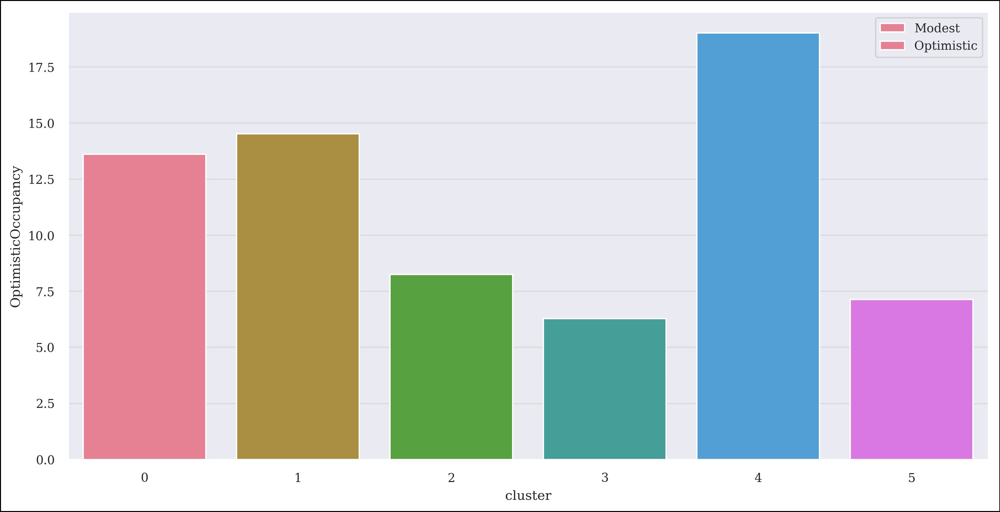

In [539]:
fig, ax = plt.subplots(figsize=(12, 6), linewidth=1)
sns.barplot(x='cluster', y='OptimisticOccupancy', data=g3, ax=ax, label="Optimistic")
plt.legend()